In [1]:
from scipy import stats
import pandas as pd
import numpy as np
from glob import glob
import os
from statsmodels.stats.multitest import multipletests

from itertools import combinations
from tqdm import tqdm

from sklearn.model_selection import train_test_split
import plot_init as pu

In [2]:
def calculate_spearmanr(arr1, arr2):
        """Calculate spearman rank correlation"""
        temp_df = pd.DataFrame()
        temp_df['arr1'] = arr1
        temp_df['arr2'] = arr2
        temp_df = temp_df.dropna()
        
        arr1 = temp_df['arr1']
        arr2 = temp_df['arr2']
        
        corr, pval = stats.spearmanr(arr1, arr2)
        return corr, pval, corr**2 # effect size   
    
def calculate_chi(arr1, arr2):
        """Calculate Chi-square test of independence"""
        temp_df = pd.DataFrame()
        temp_df['arr1'] = arr1
        temp_df['arr2'] = arr2
        temp_df = temp_df.dropna()
        
        arr1 = temp_df['arr1']
        arr2 = temp_df['arr2']
        
        row_count = arr1.nunique()
        col_count = arr2.nunique()


        contingency = pd.crosstab(arr1, arr2)
        n = contingency.sum().sum()
        
        # Chi-square test of independence.
        corr, pval, dof, expected = stats.chi2_contingency(
            contingency, correction=False, lambda_=None)
        
        # returns chi2, p_uncorrected, dof, expected, num_rows, num_cols, n
        return corr, pval, dof, expected, row_count, col_count, n
    
def bergsma_corrected_cramers_v2(chi2, row_count, col_count, n):
    """Calculate cramers_v2_corrected"""
    
    phi2 = chi2/n
    phi2_corrected = phi2 - (1/(n-1))*(row_count-1)*(col_count-1)
    phi2_corrected_nonneg = max(0, phi2_corrected)

    row_count_corrected = row_count - (1/(n-1))*(row_count-1)**2
    col_count_corrected = col_count - (1/(n-1))*(col_count-1)**2

    cramers_v2_corrected = phi2_corrected_nonneg/min(row_count_corrected-1, col_count_corrected-1)

    return cramers_v2_corrected # effect size

def kw_dunn(groups, to_compare=None, alpha=0.05, method='bonf'):
    """
    Kruskal-Wallis 1-way ANOVA with Dunn's multiple comparison test
    Arguments:
    ---------------
    groups: sequence, pd.Series
        arrays corresponding to k mutually independent samples from
        continuous populations
        For pd.Series inputs,  index is group (category) and values are arrays
        of numerical var values belonging to that group.
    to_compare: sequence
        tuples specifying the indices of pairs of groups to compare, e.g.
        [(0, 1), (0, 2)] would compare group 0 with 1 & 2. by default, all
        possible pairwise comparisons between groups are performed.
    alpha: float
        family-wise error rate used for correcting for multiple comparisons
        (see statsmodels.stats.multitest.multipletests for details)
    method: string
        method used to adjust p-values to account for multiple corrections (see
        statsmodels.stats.multitest.multipletests for options)
    Returns:
    ---------------
    H: float
        Kruskal-Wallis H-statistic
    p_omnibus: float
        p-value corresponding to the global null hypothesis that the medians of
        the groups are all equal
    Z_pairs: float array
        Z-scores computed for the absolute difference in mean ranks for each
        pairwise comparison
    p_corrected: float array
        corrected p-values for each pairwise comparison, corresponding to the
        null hypothesis that the pair of groups has equal medians. note that
        these are only meaningful if the global null hypothesis is rejected.
    reject: bool array
        True for pairs where the null hypothesis can be rejected for the given
        alpha
    Reference:
    ---------------
    Gibbons, J. D., & Chakraborti, S. (2011). Nonparametric Statistical
    Inference (5th ed., pp. 353-357). Boca Raton, FL: Chapman & Hall.
    """

    # omnibus test (K-W ANOVA)
    # -------------------------------------------------------------------------

    groups = [np.array(gg) for gg in groups]

    k = len(groups)

    n = np.array([len(gg) for gg in groups])

    if np.any(n < 5):
        warnings.warn("Sample sizes < 5 are not recommended (K-W test assumes "
                      "a chi square distribution)")

    allgroups = np.concatenate(groups)
    N = len(allgroups)

    ranked = stats.rankdata(allgroups)

    # correction factor for ties
    T = stats.tiecorrect(ranked)
    if T == 0:
        raise ValueError('All numbers are identical in kruskal')


    # sum of ranks for each group
    j = np.insert(np.cumsum(n), 0, 0)
    R = np.empty(k, dtype=float)
    for ii in range(k):
        R[ii] = ranked[j[ii]:j[ii + 1]].sum()


    # the Kruskal-Wallis H-statistic
    H = ((12. / (N * (N + 1.))) 
         * ((R ** 2.) / n).sum() - 3 * (N + 1))

    # apply correction factor for ties
    H /= T

    df_omnibus = k - 1
    p_omnibus = stats.distributions.chi2.sf(H, df_omnibus)

    # multiple comparisons
    # -------------------------------------------------------------------------
    # by default we compare every possible pair of groups
    if to_compare is None:
        to_compare = tuple(combinations(range(k), 2))

    ncomp = len(to_compare)

    Z_pairs = np.empty(ncomp, dtype=float)
    p_uncorrected = np.empty(ncomp, dtype=float)
    Rmean = R / n

    for pp, (ii, jj) in enumerate(to_compare):

        # standardized score
        Zij = (np.abs(Rmean[ii] - Rmean[jj]) /
               np.sqrt((1. / 12.) * N * (N + 1) * (1. / n[ii] + 1. / n[jj])))
        Z_pairs[pp] = Zij

    # corresponding p-values obtained from upper quantiles of the standard
    # normal distribution
    p_uncorrected = stats.norm.sf(Z_pairs) * 2.

    # correction for multiple comparisons
    reject, p_corrected, alphac_sidak, alphac_bonf = multipletests(
        p_uncorrected, method=method)


    return H, p_omnibus, Z_pairs, p_corrected, reject

def calculate_annova(cat_arr, num_arr):
    """Calculate Kruskal-Wallis anova and Dunn’s post hoc test"""
    temp_df = pd.DataFrame()
    temp_df['cat'] = cat_arr
    temp_df['num'] = num_arr
    temp_df = temp_df.dropna()
    
    alpha = 0.05
    N_samples = df.shape[0]
    
    # initialize input series, index : group, values : arr of 'num' vals per group
    input_ = temp_df.groupby('cat')['num'].apply(list)

    H, p_omnibus, Z_pairs, p_corrected, reject = kw_dunn(input_, method='bonf') 

    max_index = np.argmax(Z_pairs)
    Z_max = Z_pairs[max_index]

    p_corrected_max = (p_corrected[max_index])
    reject_max = (reject[max_index])

    #if Kruskal-Wallis analysis of variance gives a significant result, use Dunn’s post hoc test
    if p_omnibus >= alpha:
        #meaning P-value > α: The differences between the medians are not statistically significant
        pval = p_omnibus          # kw
    else: 
        pval = p_corrected_max    #dunns

    corr = Z_max / (N_samples)**0.5
    Z2_max = (Z_max**2) / N_samples


    return corr, pval, Z2_max # effect size

## Inspect Data

In [3]:
# # get paths : from re-run with new data
# data_root = '../datasets/per-vehicle-moving-average'
# lookback_window = 60
# agg = 'mean'
# date = '2023-06-16'
# src_dir = os.path.join(
#     data_root, f"{agg}-window-{lookback_window}-{date}")

# csv_paths = glob(f"{src_dir}/*.csv")

In [4]:
src_date = "2023-06-17"
src_dir = f"../datasets/processed/post-review/{src_date}"

paths = glob(os.path.join(src_dir, "*.csv"))
df = pd.DataFrame()
for path in tqdm(paths):
    df = pd.concat([df, pd.read_csv(path)])

100%|██████████| 195/195 [00:37<00:00,  5.20it/s]


In [5]:
# dtypes
# compress dtypes
dtypes_compressed = {
    'datetime': np.object_,    
    'hour': np.int8,
    'month': np.int8,
    'dayofweek': np.int8,
    'number_of_lanes': np.float32,
    
    'speed_limit_kph': np.float32,    
    
    'lon': np.float64,
    'lat': np.float64,
    'elevation': np.int16,    
    'agg_speed': np.float64,  
    
    'pix_business_4x4_200': np.int16,
    'pix_residential_4x4_200': np.int16,
    'pix_industrial_4x4_200': np.int16,
    'pix_institutional_4x4_200': np.int16,
    'pix_business_4x4_50': np.int16,
    'pix_residential_4x4_50': np.int16,
    'pix_industrial_4x4_50': np.int16,
    'pix_institutional_4x4_50': np.int16,
    'pix_business_4x4_100': np.int16,
    'pix_residential_4x4_100': np.int16,
    'pix_industrial_4x4_100': np.int16,
    'pix_institutional_4x4_100': np.int16,
    'pix_business_4x4_150': np.int16,
    'pix_residential_4x4_150': np.int16,
    'pix_industrial_4x4_150': np.int16,
    'pix_institutional_4x4_150': np.int16,
    'pix_business_4x4_250': np.int16,
    'pix_residential_4x4_250': np.int16,
    'pix_industrial_4x4_250': np.int16,
    'pix_institutional_4x4_250': np.int16,
    'pix_business_4x4_500': np.int16,
    'pix_residential_4x4_500': np.int16,
    'pix_industrial_4x4_500': np.int16,
    'pix_institutional_4x4_500': np.int16,
    'pix_business_4x4_1000': np.int16,
    'pix_residential_4x4_1000': np.int16,
    'pix_industrial_4x4_1000': np.int16,
}

In [6]:
def correct_service_rd_kphlimit(temp_df):
    temp_df.loc[temp_df['speed_limit_kph'] == 36.7, 'speed_limit_kph'] = 20
    return temp_df

def impute_lanes(df):
    df['number_of_lanes'] = df['number_of_lanes'].replace(np.nan, value=2)
    return df

def filter_brgy(df):
    df['barangay'] = df['barangay'].fillna('Out-of-town')
    
    # not in cauayan boundary
    df = df.loc[df['barangay'] != 'Out-of-town'] 
    return df

def filter_num_periods(df, thresh):
    df = df.loc[df['num_periods'] >= thresh]
    return df


def filter_vehicles(df, remove_list=None):
    df = df.loc[~df.vehicle_id.isin(remove_list)]
    return df


def prepare_df(df):
    df = df.astype(dtype=dtypes_compressed)
    
    # vehicles with erratic sending of data; stopped sending data before collection date
    remove_list = [
        123200872653, 123200872678, 
        123200872713, 123200872727, 123200872819,
    ] 
    df = filter_brgy(df)
    df = filter_vehicles(df, remove_list=remove_list)
    df = filter_num_periods(df, thresh=12)
    df = impute_lanes(df)
    df = correct_service_rd_kphlimit(df)
    df = df.drop_duplicates()
    return df

In [7]:
df = prepare_df(df)
# other metadata
print("Earliest date: ", df['datetime'].min())
print("Latest date: ", df['datetime'].max())

Earliest date:  2021-02-16 12:31:05+08:00
Latest date:  2021-11-17 07:57:14+08:00


In [8]:
# target
target = 'agg_speed'

# features
time_cols = ['hour', 'dayofweek']

road_cols = [
    'number_of_lanes', 'speed_limit_kph', 'elevation',
]

landuse_cols = []
buffer_sizes = [50, 100, 150, 200, 250, 500, 1000]    
for size in buffer_sizes:
    landuse_cols.extend(
        [
            f'pix_residential_4x4_{size}',
            f'pix_institutional_4x4_{size}',
            f'pix_industrial_4x4_{size}',
            f'pix_business_4x4_{size}',
        ]
    )
    
usecols = time_cols + road_cols + landuse_cols + [target]
df = df[usecols]

In [9]:
df.isnull().any()

hour                          False
dayofweek                     False
number_of_lanes               False
speed_limit_kph               False
elevation                     False
pix_residential_4x4_50        False
pix_institutional_4x4_50      False
pix_industrial_4x4_50         False
pix_business_4x4_50           False
pix_residential_4x4_100       False
pix_institutional_4x4_100     False
pix_industrial_4x4_100        False
pix_business_4x4_100          False
pix_residential_4x4_150       False
pix_institutional_4x4_150     False
pix_industrial_4x4_150        False
pix_business_4x4_150          False
pix_residential_4x4_200       False
pix_institutional_4x4_200     False
pix_industrial_4x4_200        False
pix_business_4x4_200          False
pix_residential_4x4_250       False
pix_institutional_4x4_250     False
pix_industrial_4x4_250        False
pix_business_4x4_250          False
pix_residential_4x4_500       False
pix_institutional_4x4_500     False
pix_industrial_4x4_500      

In [10]:
df.describe()

,hour,dayofweek,number_of_lanes,speed_limit_kph,elevation,pix_residential_4x4_50,pix_institutional_4x4_50,pix_industrial_4x4_50,pix_business_4x4_50,pix_residential_4x4_100,...,pix_business_4x4_250,pix_residential_4x4_500,pix_institutional_4x4_500,pix_industrial_4x4_500,pix_business_4x4_500,pix_residential_4x4_1000,pix_institutional_4x4_1000,pix_industrial_4x4_1000,pix_business_4x4_1000,agg_speed
count,1.333752e+06,1.333752e+06,1.333752e+06,1.333752e+06,1.333752e+06,1.333752e+06,1.333752e+06,1.333752e+06,1.333752e+06,1.333752e+06,...,1.333752e+06,1.333752e+06,1.333752e+06,1.333752e+06,1.333752e+06,1.333752e+06,1.333752e+06,1.333752e+06,1.333752e+06,1.333752e+06
mean,1.183195e+01,2.901146e+00,2.390752e+00,5.144106e+01,5.862036e+01,3.275069e+01,1.937523e+00,3.260596e+00,2.217926e+01,1.294130e+02,...,3.567417e+02,2.405047e+03,2.180933e+02,4.554829e+02,9.700387e+02,8.625921e+03,8.241784e+02,1.414735e+03,2.709903e+03,3.454474e+01
std,4.178705e+00,2.054971e+00,1.274153e+00,2.089024e+01,6.686454e+00,4.334222e+01,1.102830e+01,1.129919e+01,4.707051e+01,1.423509e+02,...,6.565443e+02,2.367256e+03,3.793976e+02,8.152466e+02,1.530468e+03,8.045078e+03,1.067757e+03,1.900242e+03,3.842546e+03,1.162819e+01
min,0.000000e+00,0.000000e+00,1.000000e+00,2.000000e+01,3.600000e+01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,8.000000e+00,1.000000e+00,1.000000e+00,3.000000e+01,5.500000e+01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,2.900000e+01,...,0.000000e+00,6.210000e+02,0.000000e+00,0.000000e+00,0.000000e+00,2.869000e+03,0.000000e+00,3.400000e+01,0.000000e+00,3.083333e+01
50%,1.200000e+01,3.000000e+00,2.000000e+00,6.000000e+01,6.000000e+01,1.600000e+01,0.000000e+00,0.000000e+00,0.000000e+00,8.500000e+01,...,4.500000e+01,1.866000e+03,8.000000e+00,7.000000e+01,2.210000e+02,5.091000e+03,2.070000e+02,6.970000e+02,8.910000e+02,3.746154e+01
75%,1.500000e+01,5.000000e+00,4.000000e+00,6.000000e+01,6.300000e+01,4.600000e+01,0.000000e+00,0.000000e+00,2.300000e+01,1.800000e+02,...,4.100000e+02,2.911000e+03,2.170000e+02,6.350000e+02,1.567000e+03,1.118000e+04,1.498250e+03,1.887000e+03,3.275000e+03,4.250000e+01
max,2.300000e+01,6.000000e+00,4.000000e+00,8.000000e+01,1.400000e+02,2.980000e+02,2.720000e+02,4.370000e+02,3.310000e+02,8.770000e+02,...,4.109000e+03,1.194600e+04,1.855000e+03,4.273000e+03,7.021000e+03,2.915200e+04,3.824000e+03,7.132000e+03,1.286800e+04,8.166667e+01


## Inspect Distributions

In [11]:
label_map = {
    'hour' : 'Hour',
    'month' : 'Month',
    'dayofweek' : 'Day of week',
    'number_of_lanes' : 'Number of Lanes',
    'speed_limit_kph' : 'Speed Limit',
    'elevation': 'Elevation (m)',
    'agg_speed' : 'Aggregated speed',
#     'road_segment_length' : 'Road segment length',    
#     'decel' : 'Deceleration',
#     'distance_to_road' : 'Vehicle distance\nto road center',
#     'accel' : 'Acceleration',    
}

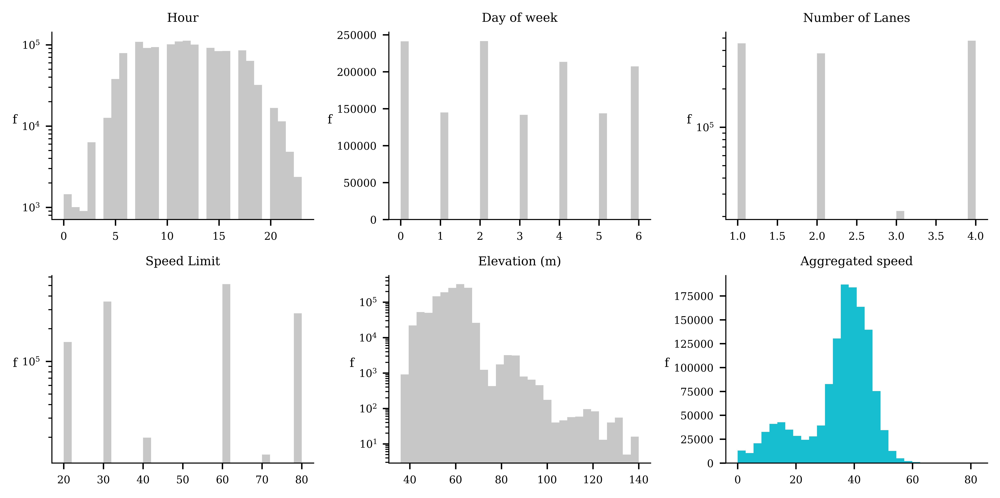

In [12]:
import matplotlib.pyplot as plt

non_landuse_cols = time_cols + road_cols + [target]

fig, axes = plt.subplots(2, 3, figsize=(8, 4))
# fig, axes = plt.subplots(2, 3, figsize=pu.figsizes['double'])

flat_axes = axes.flatten()
for index, col in enumerate(non_landuse_cols):
    color = "#C7C7C7"
    if col == 'agg_speed':
        color = "#17BECF"
    
    logy = True
    if col in ['agg_speed', 'dayofweek']:
        logy=False
    df[col].plot.hist(
        bins=30, ax=flat_axes[index], color=color, logy=logy)
    flat_axes[index].set_title(label_map[col], fontsize=pu.small)
    flat_axes[index].spines[['top', 'right']].set_visible(False)
    flat_axes[index].tick_params(axis='both', labelsize=pu.tiny)
    
#     ylabel = flat_axes[index].get_ylabel()
    flat_axes[index].set_ylabel('f', rotation=0, fontsize=pu.small)
    
# fig.text(0, 0.5, 'Frequency', va='center', rotation='vertical')
plt.tight_layout(pad=1.0)
plt.show()

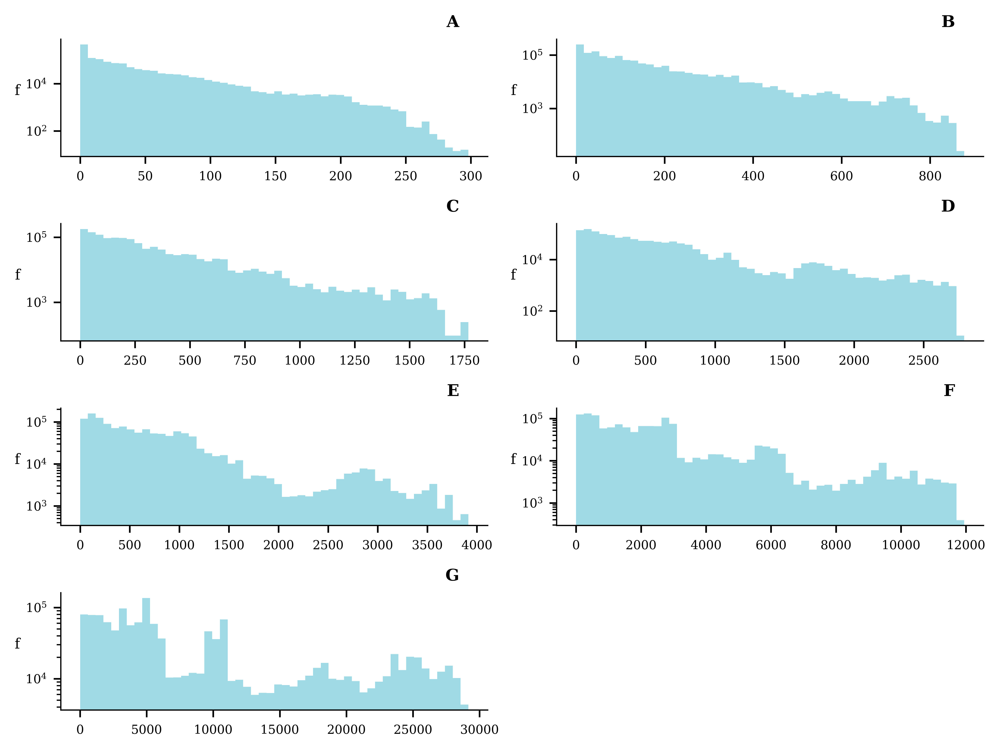

In [13]:
import matplotlib.pyplot as plt

fig, axes = plt.subplots(4, 2, figsize=pu.figsizes['double'])

landuse_type = 'residential'

flat_axes = axes.flatten()
buffer_sizes = [50, 100, 150, 200, 250, 500, 1000] # top to right, down  
buffer_labels = ['A', 'B', 'C', 'D', 'E', 'F', 'G']
for index, buffer in enumerate(buffer_sizes):
        
    df[f"pix_{landuse_type}_4x4_{buffer}"].plot.hist(
        bins=50, ax=flat_axes[index], color="#9EDAE5", logy=True)

#     flat_axes[index].set_title(
#         f"Buffer size: {buffer} meters", fontsize=pu.tiny)
    flat_axes[index].set_title(
        f"{buffer_labels[index]}     ", 
        fontsize=pu.regular, loc='right', weight="bold")

    flat_axes[index].spines[['top', 'right']].set_visible(False)
    flat_axes[index].tick_params(axis='both', labelsize=pu.tiny)

#     ylabel = flat_axes[index].get_ylabel()
    flat_axes[index].set_ylabel('f', rotation=0, fontsize=pu.small)
    
for axes in flat_axes[index + 1:]:
    axes.remove()
    
# fig.text(0, 0.5, 'Frequency', va='center', rotation='vertical')
plt.tight_layout(pad=1.0)
plt.show()

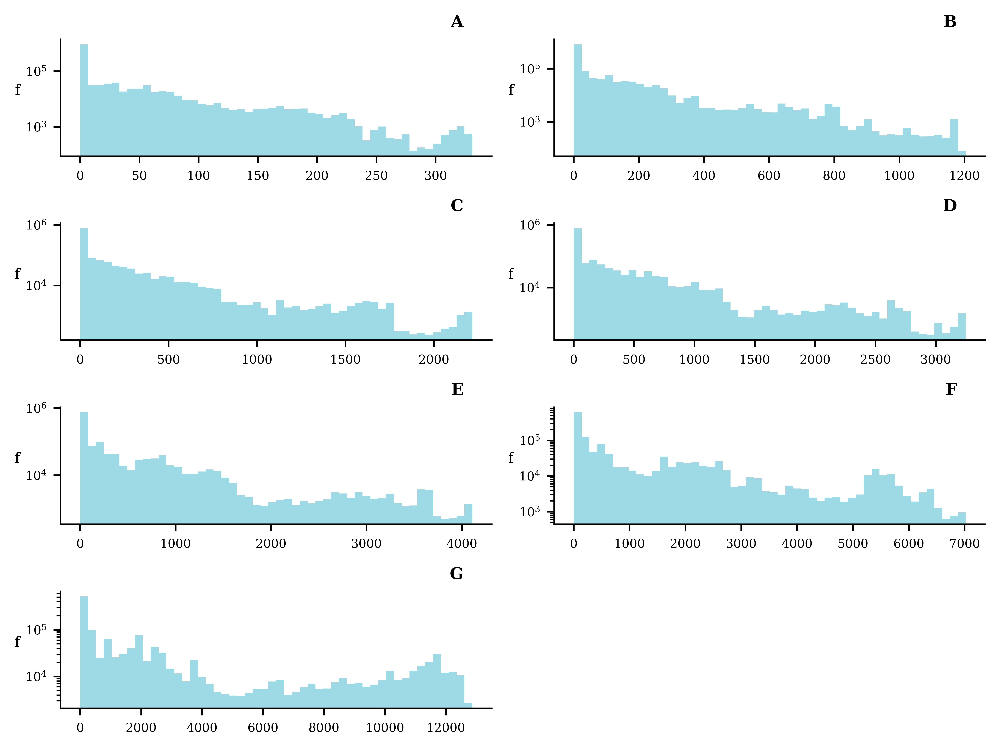

In [14]:
import matplotlib.pyplot as plt

fig, axes = plt.subplots(4, 2, figsize=pu.figsizes['double'])

landuse_type = 'business'

flat_axes = axes.flatten()
buffer_sizes = [50, 100, 150, 200, 250, 500, 1000] # top to right, down  
buffer_labels = ['A', 'B', 'C', 'D', 'E', 'F', 'G']
for index, buffer in enumerate(buffer_sizes):
        
    df[f"pix_{landuse_type}_4x4_{buffer}"].plot.hist(
        bins=50, ax=flat_axes[index], color="#9EDAE5", logy=True)

#     flat_axes[index].set_title(
#         f"Buffer size: {buffer} meters", fontsize=pu.tiny)
    flat_axes[index].set_title(
        f"{buffer_labels[index]}     ", 
        fontsize=pu.regular, loc='right', weight="bold")

    flat_axes[index].spines[['top', 'right']].set_visible(False)
    flat_axes[index].tick_params(axis='both', labelsize=pu.tiny)

#     ylabel = flat_axes[index].get_ylabel()
    flat_axes[index].set_ylabel('f', rotation=0, fontsize=pu.small)
    
for axes in flat_axes[index + 1:]:
    axes.remove()
    
# fig.text(0, 0.5, 'Frequency', va='center', rotation='vertical')
plt.tight_layout(pad=1.0)
plt.show()

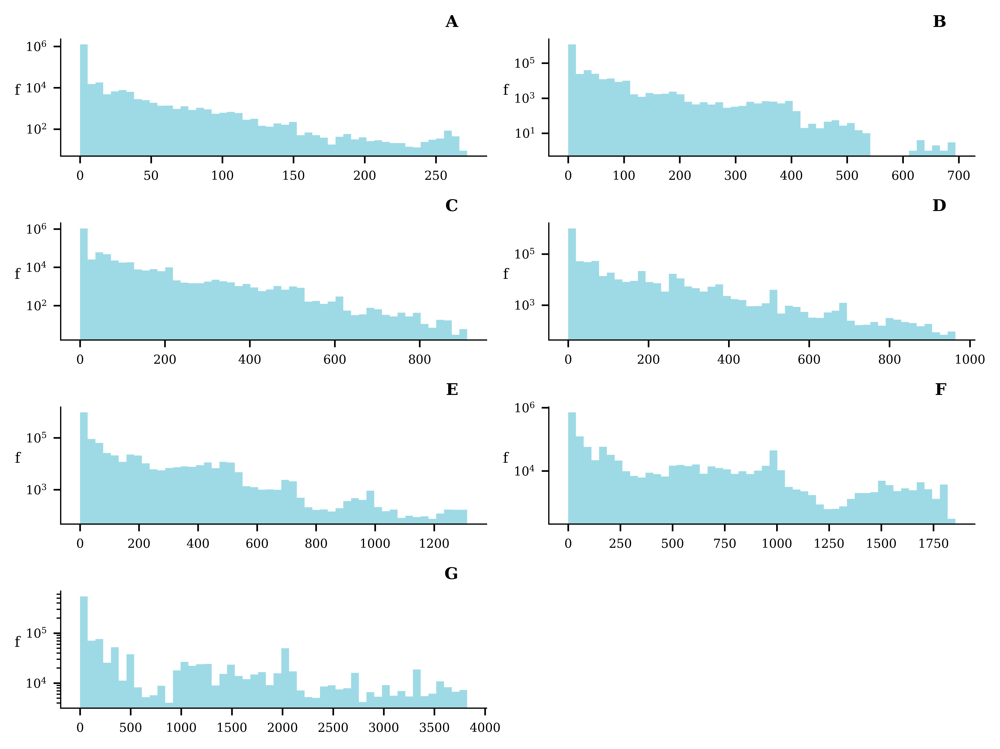

In [15]:
import matplotlib.pyplot as plt

fig, axes = plt.subplots(4, 2, figsize=pu.figsizes['double'])

landuse_type = 'institutional'

flat_axes = axes.flatten()
buffer_sizes = [50, 100, 150, 200, 250, 500, 1000] # top to right, down  
buffer_labels = ['A', 'B', 'C', 'D', 'E', 'F', 'G']
for index, buffer in enumerate(buffer_sizes):
        
    df[f"pix_{landuse_type}_4x4_{buffer}"].plot.hist(
        bins=50, ax=flat_axes[index], color="#9EDAE5", logy=True)

#     flat_axes[index].set_title(
#         f"Buffer size: {buffer} meters", fontsize=pu.tiny)
    flat_axes[index].set_title(
        f"{buffer_labels[index]}     ", 
        fontsize=pu.regular, loc='right', weight="bold")

    flat_axes[index].spines[['top', 'right']].set_visible(False)
    flat_axes[index].tick_params(axis='both', labelsize=pu.tiny)

#     ylabel = flat_axes[index].get_ylabel()
    flat_axes[index].set_ylabel('f', rotation=0, fontsize=pu.small)
    
for axes in flat_axes[index + 1:]:
    axes.remove()
    
# fig.text(0, 0.5, 'Frequency', va='center', rotation='vertical')
plt.tight_layout(pad=1.0)
plt.show()

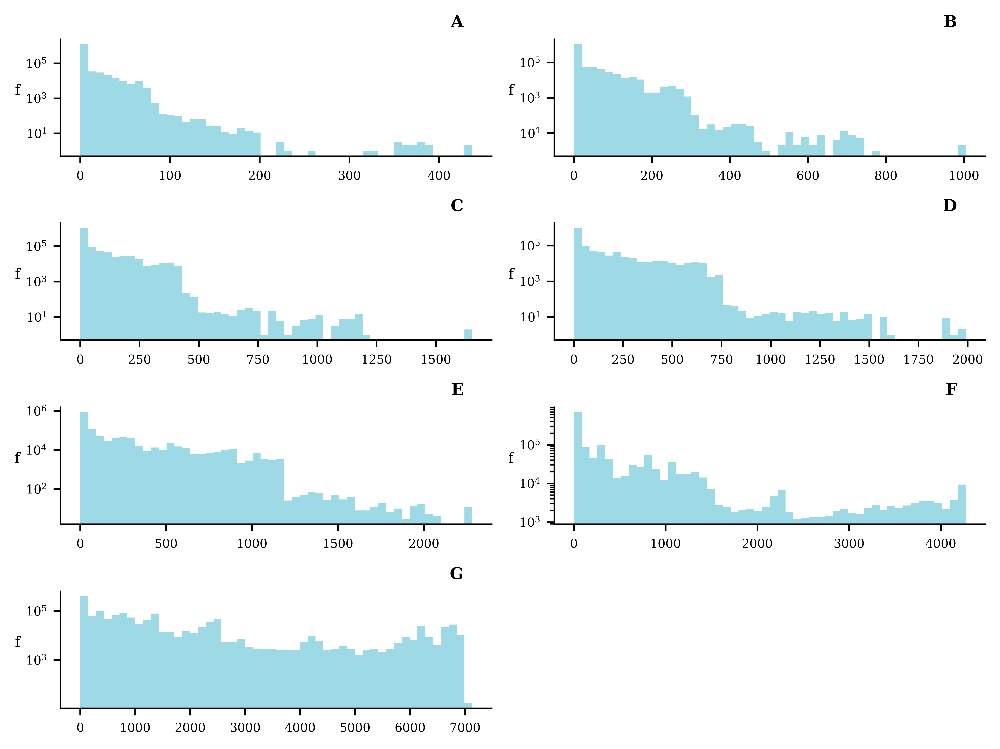

In [16]:
import matplotlib.pyplot as plt

fig, axes = plt.subplots(4, 2, figsize=pu.figsizes['double'])

landuse_type = 'industrial'

flat_axes = axes.flatten()
buffer_sizes = [50, 100, 150, 200, 250, 500, 1000] # top to right, down  
buffer_labels = ['A', 'B', 'C', 'D', 'E', 'F', 'G']
for index, buffer in enumerate(buffer_sizes):
        
    df[f"pix_{landuse_type}_4x4_{buffer}"].plot.hist(
        bins=50, ax=flat_axes[index], color="#9EDAE5", logy=True)

#     flat_axes[index].set_title(
#         f"Buffer size: {buffer} meters", fontsize=pu.tiny)
    flat_axes[index].set_title(
        f"{buffer_labels[index]}     ", 
        fontsize=pu.regular, loc='right', weight="bold")

    flat_axes[index].spines[['top', 'right']].set_visible(False)
    flat_axes[index].tick_params(axis='both', labelsize=pu.tiny)

#     ylabel = flat_axes[index].get_ylabel()
    flat_axes[index].set_ylabel('f', rotation=0, fontsize=pu.small)
    
for axes in flat_axes[index + 1:]:
    axes.remove()
    
# fig.text(0, 0.5, 'Frequency', va='center', rotation='vertical')
plt.tight_layout(pad=1.0)
plt.show()

## Calculate Effect Sizes, Correlations, and p-values

In [17]:
# categorical_cols = ['hour', 'dayofweek', 'number_of_lanes', 'speed_limit_kph']
categorical_cols = ['hour', 'dayofweek']
numerical_cols = [i for i in df.columns if i not in categorical_cols]

# features = list(sorted(set(df.columns) - set(['agg_speed'])))
features = list(sorted(set(df.columns)))
feature_combinations = list(combinations(features, 2))

effect_size_df = pd.DataFrame(index=usecols, columns=usecols)
corr_df = pd.DataFrame(index=usecols, columns=usecols)
pval_df = pd.DataFrame(index=usecols, columns=usecols)

for feat1, feat2 in tqdm(feature_combinations):
    if (feat1 in categorical_cols) & (feat2 in categorical_cols): # chi2-cramersv
        arr1, arr2 = df[feat1], df[feat2]
        corr, pval, dof, expected, row_count, col_count, n = calculate_chi(arr1, arr2)
        
        # corrected cramersv, corr is chi2
        effect_size = bergsma_corrected_cramers_v2(corr, row_count, col_count, n)
    
    elif (feat1 in numerical_cols) & (feat2 in numerical_cols): # spearmanr
        arr1, arr2 = df[feat1], df[feat2]
        corr, pval, effect_size = calculate_spearmanr(arr1, arr2)
    
    else:
        if feat1 in categorical_cols: # feat1 is cat
            # Z2_max : effect_size
            cat_arr = df[feat1]
            num_arr = df[feat2]
        else: # feat2 is cat
            cat_arr = df[feat2]
            num_arr = df[feat1]
            
        corr, pval, effect_size = calculate_annova(cat_arr, num_arr)
    
    effect_size_df.loc[feat1, feat2] = effect_size
    corr_df.loc[feat1, feat2] = corr
    pval_df.loc[feat1, feat2] = pval

100%|██████████| 561/561 [03:50<00:00,  2.43it/s]


In [18]:
effect_size_df

,hour,dayofweek,number_of_lanes,speed_limit_kph,elevation,pix_residential_4x4_50,pix_institutional_4x4_50,pix_industrial_4x4_50,pix_business_4x4_50,pix_residential_4x4_100,...,pix_business_4x4_250,pix_residential_4x4_500,pix_institutional_4x4_500,pix_industrial_4x4_500,pix_business_4x4_500,pix_residential_4x4_1000,pix_institutional_4x4_1000,pix_industrial_4x4_1000,pix_business_4x4_1000,agg_speed
hour,NaN,NaN,0.00196,0.002773,NaN,0.000248,0.000094,0.000102,0.000483,0.0005,...,0.001359,0.001572,0.001052,0.001735,0.001738,0.001763,0.001639,0.001729,0.00197,NaN
dayofweek,0.002091,NaN,0.000856,0.000553,0.000278,0.0012,0.000235,0.000113,0.001105,0.001965,...,0.002398,0.004074,0.002068,0.001869,0.002833,0.004203,0.003155,0.002139,0.002978,NaN
number_of_lanes,NaN,NaN,NaN,0.376528,NaN,0.007455,0.000236,0.044319,0.116621,0.001996,...,0.165975,0.014463,0.051488,0.174963,0.146625,0.054298,0.084695,0.17865,0.137919,NaN
speed_limit_kph,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
elevation,0.001113,NaN,0.011055,0.048737,NaN,0.014821,0.000346,0.026094,0.000481,0.014403,...,0.003799,0.000087,0.033055,0.076066,0.011559,0.015107,0.039391,0.049921,0.02339,NaN
pix_residential_4x4_50,NaN,NaN,NaN,0.000002,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,0.152126,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
pix_institutional_4x4_50,NaN,NaN,NaN,0.010786,NaN,0.017505,NaN,NaN,NaN,0.019744,...,NaN,0.066671,0.094878,NaN,NaN,0.062456,NaN,NaN,NaN,NaN
pix_industrial_4x4_50,NaN,NaN,NaN,0.04051,NaN,0.000035,0.002131,NaN,NaN,0.000144,...,NaN,0.006035,0.000088,0.171852,NaN,0.005315,0.003347,NaN,NaN,NaN
pix_business_4x4_50,NaN,NaN,NaN,0.000882,NaN,0.0,0.021607,0.014551,NaN,0.028597,...,NaN,0.356019,0.372317,0.098516,0.520006,0.397142,0.41493,0.168496,NaN,NaN
pix_residential_4x4_100,NaN,NaN,NaN,0.001064,NaN,0.698841,NaN,NaN,NaN,NaN,...,NaN,0.352385,NaN,NaN,NaN,0.212623,NaN,NaN,NaN,NaN


In [19]:
pval_df

,hour,dayofweek,number_of_lanes,speed_limit_kph,elevation,pix_residential_4x4_50,pix_institutional_4x4_50,pix_industrial_4x4_50,pix_business_4x4_50,pix_residential_4x4_100,...,pix_business_4x4_250,pix_residential_4x4_500,pix_institutional_4x4_500,pix_industrial_4x4_500,pix_business_4x4_500,pix_residential_4x4_1000,pix_institutional_4x4_1000,pix_industrial_4x4_1000,pix_business_4x4_1000,agg_speed
hour,NaN,NaN,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN
dayofweek,0.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN
number_of_lanes,NaN,NaN,NaN,0.0,NaN,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN
speed_limit_kph,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
elevation,0.0,NaN,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN
pix_residential_4x4_50,NaN,NaN,NaN,0.075703,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
pix_institutional_4x4_50,NaN,NaN,NaN,0.0,NaN,0.0,NaN,NaN,NaN,0.0,...,NaN,0.0,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN
pix_industrial_4x4_50,NaN,NaN,NaN,0.0,NaN,0.0,0.0,NaN,NaN,0.0,...,NaN,0.0,0.0,0.0,NaN,0.0,0.0,NaN,NaN,NaN
pix_business_4x4_50,NaN,NaN,NaN,0.0,NaN,0.598225,0.0,0.0,NaN,0.0,...,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN
pix_residential_4x4_100,NaN,NaN,NaN,0.0,NaN,0.0,NaN,NaN,NaN,NaN,...,NaN,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN


## Inspect Effect Size Network

In [20]:
edge_list = pd.concat([effect_size_df.stack(), pval_df.stack()], axis=1)
edge_list = edge_list.reset_index()
edge_list.columns = ['source', 'target', 'effect_size', 'pval']
edge_list.info()
# edge_list = edge_list[edge_list.pval <= 0.05] # usual alpha

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 561 entries, 0 to 560
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   source       561 non-null    object
 1   target       561 non-null    object
 2   effect_size  561 non-null    object
 3   pval         561 non-null    object
dtypes: object(4)
memory usage: 17.7+ KB


In [21]:
temp_edge_list = edge_list[edge_list.effect_size >= 0.5]
temp_edge_list = temp_edge_list.sort_values(
    by='effect_size', ascending=False)
temp_edge_list

,source,target,effect_size,pval
354,pix_business_4x4_200,pix_business_4x4_250,0.967469,0.0
306,pix_residential_4x4_200,pix_residential_4x4_250,0.955918,0.0
292,pix_business_4x4_150,pix_business_4x4_200,0.947507,0.0
244,pix_residential_4x4_150,pix_residential_4x4_200,0.927389,0.0
225,pix_business_4x4_100,pix_business_4x4_150,0.906849,0.0
...,...,...,...,...
298,pix_business_4x4_150,pix_institutional_4x4_500,0.525316,0.0
456,pix_business_4x4_500,pix_residential_4x4_500,0.521534,0.0
168,pix_business_4x4_50,pix_business_4x4_500,0.520006,0.0
275,pix_industrial_4x4_150,pix_industrial_4x4_500,0.51761,0.0


In [22]:
alpha = 0.05
corrected_alpha = alpha / len(feature_combinations)
corrected_alpha

8.912655971479502e-05

In [23]:
# filter based on p-val
print("Before pval filter: ", edge_list.shape)
edge_list = edge_list.loc[edge_list.pval < corrected_alpha]
print("After pval filter: ", edge_list.shape)

Before pval filter:  (561, 4)
After pval filter:  (556, 4)


In [24]:
# edge_list['source'] = edge_list['source'].apply(
#     lambda x: "_".join([x.split("_")[1][:3], x.split("_")[-1]]) 
#     if x.startswith("pix_") else x) 
# edge_list['target'] = edge_list['target'].apply(
#     lambda x: "_".join([x.split("_")[1][:3], x.split("_")[-1]]) 
#     if x.startswith("pix_") else x) 

In [25]:
import networkx as nx
import matplotlib.pyplot as plt

G = nx.from_pandas_edgelist(edge_list,  edge_attr=True)
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
ax.spines[['right', 'top', 'left', 'bottom']].set_visible(False)

weights = list(nx.get_edge_attributes(G,'effect_size').values())
# nx.draw_networkx(G) 
# weighted according to effect size
pos = nx.circular_layout(G)
labels = {k:"\n".join([k.split("_")[1][:3], k.split("_")[-1]]) 
          if k.startswith("pix_") else k for k,_ in pos.items()}

edge_colors = ["#17BECF" if weight >= 0.5 else "k" for weight in weights]

# emphasize weights
weights = [weight * 1.5 if weight >= 0.5 else weight * 0.8 for weight in weights]

nx.draw(
    G, pos=pos, width=weights, with_labels=True,
    labels=labels,
    node_color="whitesmoke", font_size=10,
    font_color="#7F7F7F", node_size=100, font_weight="bold",
    edge_color=edge_colors,
)
    
plt.show()

## Generate Correlation Heatmap

In [26]:
target_var = 'agg_speed'

adj_mat = nx.adjacency_matrix(G, weight='effect_size').todense()
adj_df = pd.DataFrame(adj_mat, columns=G.nodes, index=G.nodes)
np.fill_diagonal(adj_df.values, 1.0)

adj_df

,hour,number_of_lanes,speed_limit_kph,pix_residential_4x4_50,pix_institutional_4x4_50,pix_industrial_4x4_50,pix_business_4x4_50,pix_residential_4x4_100,pix_institutional_4x4_100,pix_industrial_4x4_100,...,pix_institutional_4x4_500,pix_industrial_4x4_500,pix_business_4x4_500,pix_residential_4x4_1000,pix_institutional_4x4_1000,pix_industrial_4x4_1000,pix_business_4x4_1000,dayofweek,elevation,agg_speed
hour,1.000000,0.001960,0.002773,0.000248,0.000094,0.000102,0.000483,0.000500,0.000156,0.000430,...,0.001052,0.001735,0.001738,0.001763,0.001639,0.001729,0.001970,0.002091,0.001113,0.007697
number_of_lanes,0.001960,1.000000,0.376528,0.007455,0.000236,0.044319,0.116621,0.001996,0.006991,0.085805,...,0.051488,0.174963,0.146625,0.054298,0.084695,0.178650,0.137919,0.000856,0.011055,0.090675
speed_limit_kph,0.002773,0.376528,1.000000,0.000000,0.010786,0.040510,0.000882,0.001064,0.004571,0.089558,...,0.005102,0.148915,0.000857,0.000601,0.011219,0.119762,0.007239,0.000553,0.048737,0.179998
pix_residential_4x4_50,0.000248,0.007455,0.000000,1.000000,0.017505,0.000035,0.000000,0.698841,0.031736,0.002954,...,0.039747,0.008094,0.014778,0.077113,0.025285,0.008319,0.011065,0.001200,0.014821,0.042575
pix_institutional_4x4_50,0.000094,0.000236,0.010786,0.017505,1.000000,0.002131,0.021607,0.019744,0.389933,0.000532,...,0.094878,0.000373,0.063899,0.062456,0.068422,0.001871,0.068719,0.000235,0.000346,0.044569
pix_industrial_4x4_50,0.000102,0.044319,0.040510,0.000035,0.002131,1.000000,0.014551,0.000144,0.003814,0.532528,...,0.000088,0.171852,0.005016,0.005315,0.003347,0.112183,0.001324,0.000113,0.026094,0.014652
pix_business_4x4_50,0.000483,0.116621,0.000882,0.000000,0.021607,0.014551,1.000000,0.028597,0.116502,0.025544,...,0.372317,0.098516,0.520006,0.397142,0.414930,0.168496,0.448315,0.001105,0.000481,0.054102
pix_residential_4x4_100,0.000500,0.001996,0.001064,0.698841,0.019744,0.000144,0.028597,1.000000,0.068662,0.002889,...,0.129436,0.018813,0.068754,0.212623,0.095208,0.032094,0.058603,0.001965,0.014403,0.072927
pix_institutional_4x4_100,0.000156,0.006991,0.004571,0.031736,0.389933,0.003814,0.116502,0.068662,1.000000,0.001362,...,0.272942,0.000921,0.166927,0.137187,0.162522,0.010894,0.137382,0.000462,0.001609,0.046208
pix_industrial_4x4_100,0.000430,0.085805,0.089558,0.002954,0.000532,0.532528,0.025544,0.002889,0.001362,1.000000,...,0.001507,0.358378,0.014522,0.010897,0.008787,0.233036,0.004154,0.000375,0.044537,0.025787


In [27]:
# filter adj_df : corr of pixel counts
pixel_count_tags = [col for col in adj_df.columns if col.startswith("pix_")]

adj_df = adj_df.loc[pixel_count_tags, pixel_count_tags]

rename_map = {
    k:"_".join([k.split("_")[1][:3], k.split("_")[-1]]) for k in pixel_count_tags}
adj_df.columns = [rename_map.get(col) for col in adj_df.columns]
adj_df.index = [rename_map.get(col) for col in adj_df.index]

In [28]:
adj_df = adj_df[sorted(adj_df.columns)]
adj_df = adj_df.loc[sorted(adj_df.index)]
adj_df

,bus_100,bus_1000,bus_150,bus_200,bus_250,bus_50,bus_500,ind_100,ind_1000,ind_150,...,ins_250,ins_50,ins_500,res_100,res_1000,res_150,res_200,res_250,res_50,res_500
bus_100,1.000000,0.586704,0.906849,0.841388,0.800652,0.821714,0.671128,0.028791,0.202172,0.037688,...,0.396628,0.041268,0.450149,0.041010,0.490826,0.098702,0.156573,0.209365,0.003705,0.437164
bus_1000,0.586704,1.000000,0.668848,0.725927,0.766908,0.448315,0.903162,0.004154,0.190959,0.009686,...,0.370100,0.068719,0.593246,0.058603,0.677118,0.122491,0.188927,0.256135,0.011065,0.491304
bus_150,0.906849,0.668848,1.000000,0.947507,0.902761,0.723987,0.760689,0.025875,0.228200,0.036085,...,0.430018,0.053851,0.525316,0.048232,0.536236,0.104913,0.167958,0.228409,0.006601,0.462644
bus_200,0.841388,0.725927,0.947507,1.000000,0.967469,0.667951,0.825036,0.023865,0.242126,0.038416,...,0.450334,0.060716,0.569915,0.050987,0.567616,0.110190,0.175562,0.237934,0.008939,0.478603
bus_250,0.800652,0.766908,0.902761,0.967469,1.000000,0.637255,0.869127,0.023807,0.248681,0.039505,...,0.458315,0.062336,0.595768,0.053163,0.590356,0.116279,0.184663,0.249631,0.009520,0.491309
bus_50,0.821714,0.448315,0.723987,0.667951,0.637255,1.000000,0.520006,0.025544,0.168496,0.033262,...,0.319894,0.021607,0.372317,0.028597,0.397142,0.081612,0.125116,0.164613,0.000000,0.356019
bus_500,0.671128,0.903162,0.760689,0.825036,0.869127,0.520006,1.000000,0.014522,0.229870,0.026398,...,0.446120,0.063899,0.635238,0.068754,0.663832,0.139012,0.210701,0.280875,0.014778,0.521534
ind_100,0.028791,0.004154,0.025875,0.023865,0.023807,0.025544,0.014522,1.000000,0.233036,0.739844,...,0.000813,0.000532,0.001507,0.002889,0.010897,0.004657,0.006192,0.007527,0.002954,0.013057
ind_1000,0.202172,0.190959,0.228200,0.242126,0.248681,0.168496,0.229870,0.233036,1.000000,0.360578,...,0.064558,0.001871,0.143086,0.032094,0.258508,0.062650,0.087803,0.108720,0.008319,0.197407
ind_150,0.037688,0.009686,0.036085,0.038416,0.039505,0.033262,0.026398,0.739844,0.360578,1.000000,...,0.000562,0.000129,0.008190,0.008890,0.024441,0.009831,0.011697,0.013912,0.006638,0.024963


In [29]:
import seaborn as sns

# Generate a mask for the upper triangle
mask = np.triu(m=np.ones_like(adj_df, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(10, 10))
# f, ax = plt.subplots(figsize=pu.figsizes['double'])

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

sns.set_context("paper", rc={"font.size":10,"axes.titlesize":15,"axes.labelsize":15})   

ax.tick_params(axis='both', left=False, bottom=False, labelsize=pu.tiny)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(adj_df, 
            mask=mask, 
            cmap=cmap, 
            annot=True, fmt='.2f', annot_kws={"size": 6},
            vmax=1.0, vmin=0.0, center=0,
            square=True, 
            linewidths=1.0, 
            cbar_kws={
                "shrink": 0.5, 'label':'Effect size', 'pad' : -0.1,
            },
            ax=ax)

xlabels = ax.get_xticklabels()
ylabels = ax.get_yticklabels()
xlabels[-1] = ylabels[0] = "" # remove 1st and last labels

ax.set_yticklabels(ylabels)
ax.set_xticklabels(xlabels)

ax.collections[0].colorbar.outline.set_color("black")
ax.collections[0].colorbar.outline.set_linewidth(0.5)
ax.collections[0].colorbar.ax.tick_params(labelsize=pu.tiny, width=0.5)
cbar_ylabel = ax.collections[0].colorbar.ax.get_ylabel()
ax.collections[0].colorbar.ax.set_ylabel(cbar_ylabel, fontsize=pu.label_size)

# ax.set_title('Effect Size Heatmap of Features', fontsize=20)

# plt.savefig('../figures/effect_size_heatmap_FULL.pdf', bbox_inches='tight')
# plt.savefig('../figures/effect_size_heatmap_FILTERED.pdf', bbox_inches='tight')
plt.show()

## End